 # Small Sample Models

In [1]:
import glob
import json
import pandas as pd
import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt
import pycaret

### Data prep

Working with 2 datasets: Uptime and uptime only

In [2]:
fn_list = glob.glob('../AudioDataArchive/08-03-23/*.parquet')
print("# files: ",len(fn_list))
df = pd.DataFrame()
for file in fn_list:
    tdf = pd.read_parquet(file)
    if df.empty:
        df = tdf
    else:
        df = pd.concat([df, tdf])
df.reset_index(drop=True, inplace=True)
df2 = pd.concat([df.loc[:,['timestamp']],df.loc[:].value.apply(json.loads).apply(pd.Series)], axis=1) # Break down into dataframe
#df2=(df2-df2.min())/(df2.max()-df2.min()) # Standardization
uptime = df2[df2['ZM6_MillRPM'] > 0] # Eliminate downtime
downtime = df2[df2['ZM6_MillFPM'] <= 0]

# files:  87


In [12]:
uptime.drop(['timestamp'],inplace= True,axis = 1)

In [3]:
uptime_sample = uptime.sample(n=20000,random_state=1)
uptime_sample.reset_index(drop=True,inplace=True)
uptime_sample

,timestamp,ZM6_MillRPM,ZM6_MillFPM,ZM6_RightTension,ZM6_LeftTension,WMAX0,RMS0,GNDOFF0,ZCS0,WMAX1,ZCS1,RMS1,GNDOFF1
0,9.385376e+06,36.899998,19.935530,2.514950e+02,2.405749e+02,0.030420,0.004507,1.652222,44448.0,0.016308,13099.0,0.004791,1.655029
1,9.026916e+06,0.060000,0.000000,0.000000e+00,0.000000e+00,0.012417,0.006083,1.652084,202.0,0.017008,43435.0,0.003641,1.655729
2,8.460383e+06,501.899963,271.483154,2.106037e+02,2.053019e+02,0.116624,0.028221,1.652221,35590.0,0.016706,28105.0,0.004052,1.654621
3,9.262740e+06,37.079998,20.029552,1.234234e+02,1.167995e+02,0.018337,0.003005,1.655833,38647.0,0.031152,46792.0,0.005311,1.655908
4,9.117652e+06,197.279984,106.626930,2.104457e+02,2.114675e+02,0.012268,0.006308,1.652234,102.0,0.017265,42369.0,0.003558,1.655986
...,...,...,...,...,...,...,...,...,...,...,...,...,...
19995,1.024156e+07,151.619980,81.962082,1.860582e+02,1.895691e+02,0.012422,0.006560,1.652080,114.0,0.028280,47282.0,0.004832,1.655721
19996,8.893316e+06,0.060000,0.000000,2.933714e-18,3.016484e-18,0.011702,0.005772,1.652800,1750.0,0.019750,44953.0,0.003894,1.656054
19997,8.745431e+06,37.079998,20.091722,3.608587e+02,3.073553e+02,0.049345,0.011296,1.652214,16749.0,0.019144,41192.0,0.004199,1.655026
19998,9.474167e+06,0.060000,0.000000,0.000000e+00,0.000000e+00,0.011987,0.005626,1.652515,3576.0,0.028809,47921.0,0.005041,1.655029


### Setup
    - Normalization methods
        - minmax
        - robust
        - zscore
        - maxabs
    - Machine Learning methods
        - Supervised
            - Regression
        - Unsupervised
            -clustering
            - Anomaly detection
    - Feature Engineering
        - polynomial features
        - group features
        - bin numeric features
        - feature importance/selection
        - remove multicollinearity
        - PCA
    - Miscellaneous
        - cross validation
        -



### Machine Learning
#### Clustering


#### Clustering with Feature Engineering

In [14]:
from pycaret.clustering import *
s = setup(uptime_sample,normalize_method='robust',normalize=True, polynomial_features = True,session_id=123)
set = pull()
print(set)

               Description                 Value
0               Session id                   123
1      Original data shape           (20000, 13)
2   Transformed data shape          (20000, 104)
3         Numeric features                    13
4               Preprocess                  True
5          Imputation type                simple
6       Numeric imputation                  mean
7   Categorical imputation                  mode
8      Polynomial features                  True
9        Polynomial degree                     2
10               Normalize                  True
11        Normalize method                robust
12                CPU Jobs                    -1
13                 Use GPU                 False
14          Log Experiment                 False
15         Experiment Name  cluster-default-name
16                     USI                  3a31


In [ ]:
dbscan = create_model('birch')
view = pull()
print(view)
dbscan_cluster = assign_model(dbscan)
view = pull()
print(view)
print(dbscan_cluster)
plot_model(dbscan, plot = 'cluster')

,,
,,
Initiated,. . . . . . . . . . . . . . . . . .,11:16:05
Status,. . . . . . . . . . . . . . . . . .,Loading Dependencies
Estimator,. . . . . . . . . . . . . . . . . .,Compiling Library


Processing:   0%|          | 0/3 [00:00<?, ?it/s]

In [ ]:
from pycaret.clustering import *
s = setup(uptime_sample,normalize_method='robust',normalize=True, polynomial_features = True,session_id=123,group_features = ['LeftTension','RightTension'])
set = pull()
print(set)

In [ ]:
dbscan = create_model('birch')
view = pull()
print(view)
dbscan_cluster = assign_model(dbscan)
view = pull()
print(view)
print(dbscan_cluster)
plot_model(dbscan, plot = 'cluster')

In [ ]:
from pycaret.clustering import *
s = setup(uptime_sample,normalize_method='robust',normalize=True, polynomial_features = True,session_id=123,, bin_numeric_features = ['RMS0','RMS1','ZCS1','ZCS0'])
set = pull()
print(set)

In [ ]:
dbscan = create_model('birch')
view = pull()
print(view)
dbscan_cluster = assign_model(dbscan)
view = pull()
print(view)
print(dbscan_cluster)
plot_model(dbscan, plot = 'cluster')

##### Max Abs Normalization

In [11]:
from pycaret.clustering import *
s = setup(uptime_sample,normalize_method='maxabs',normalize=True,session_id=123)
set = pull()
print(set)

               Description                 Value
0               Session id                   123
1      Original data shape           (20000, 13)
2   Transformed data shape           (20000, 13)
3         Numeric features                    13
4               Preprocess                  True
5          Imputation type                simple
6       Numeric imputation                  mean
7   Categorical imputation                  mode
8                Normalize                  True
9         Normalize method                maxabs
10                CPU Jobs                    -1
11                 Use GPU                 False
12          Log Experiment                 False
13         Experiment Name  cluster-default-name
14                     USI                  fad2


In [12]:
print(set)
dbscan = create_model('birch')
view = pull()
print(view)
dbscan_cluster = assign_model(dbscan)
view = pull()
print(view)
print(dbscan_cluster)
plot_model(dbscan, plot='cluster')

               Description                 Value
0               Session id                   123
1      Original data shape           (20000, 13)
2   Transformed data shape           (20000, 13)
3         Numeric features                    13
4               Preprocess                  True
5          Imputation type                simple
6       Numeric imputation                  mean
7   Categorical imputation                  mode
8                Normalize                  True
9         Normalize method                maxabs
10                CPU Jobs                    -1
11                 Use GPU                 False
12          Log Experiment                 False
13         Experiment Name  cluster-default-name
14                     USI                  fad2


,,
,,
Initiated,. . . . . . . . . . . . . . . . . .,11:06:45
Status,. . . . . . . . . . . . . . . . . .,Loading Dependencies
Estimator,. . . . . . . . . . . . . . . . . .,Compiling Library


Processing:   0%|          | 0/3 [00:00<?, ?it/s]

   Silhouette  Calinski-Harabasz  Davies-Bouldin  Homogeneity  Rand Index  \
0      0.2802          6157.2684          1.1235            0           0   

   Completeness  
0             0  
   Silhouette  Calinski-Harabasz  Davies-Bouldin  Homogeneity  Rand Index  \
0      0.2802          6157.2684          1.1235            0           0   

   Completeness  
0             0  
        timestamp  ZM6_MillRPM  ZM6_MillFPM  ZM6_RightTension  \
0       9385376.0    36.899998    19.935530      2.514950e+02   
1       9026916.0     0.060000     0.000000      0.000000e+00   
2       8460383.0   501.899963   271.483154      2.106037e+02   
3       9262740.0    37.079998    20.029552      1.234234e+02   
4       9117652.0   197.279984   106.626930      2.104457e+02   
...           ...          ...          ...               ...   
19995  10241562.0   151.619980    81.962082      1.860582e+02   
19996   8893316.0     0.060000     0.000000      2.933714e-18   
19997   8745431.0    37.079998   

In [13]:
print(set)
dbscan = create_model('dbscan')
view = pull()
print(view)
dbscan_cluster = assign_model(dbscan)
view = pull()
print(view)
print(dbscan_cluster)
plot_model(dbscan, plot='cluster')

               Description                 Value
0               Session id                   123
1      Original data shape           (20000, 13)
2   Transformed data shape           (20000, 13)
3         Numeric features                    13
4               Preprocess                  True
5          Imputation type                simple
6       Numeric imputation                  mean
7   Categorical imputation                  mode
8                Normalize                  True
9         Normalize method                maxabs
10                CPU Jobs                    -1
11                 Use GPU                 False
12          Log Experiment                 False
13         Experiment Name  cluster-default-name
14                     USI                  fad2


,,
,,
Initiated,. . . . . . . . . . . . . . . . . .,11:07:55
Status,. . . . . . . . . . . . . . . . . .,Loading Dependencies
Estimator,. . . . . . . . . . . . . . . . . .,Compiling Library


Processing:   0%|          | 0/3 [00:00<?, ?it/s]

   Silhouette  Calinski-Harabasz  Davies-Bouldin  Homogeneity  Rand Index  \
0       0.383             18.206          1.6222            0           0   

   Completeness  
0             0  
   Silhouette  Calinski-Harabasz  Davies-Bouldin  Homogeneity  Rand Index  \
0       0.383             18.206          1.6222            0           0   

   Completeness  
0             0  
        timestamp  ZM6_MillRPM  ZM6_MillFPM  ZM6_RightTension  \
0       9385376.0    36.899998    19.935530      2.514950e+02   
1       9026916.0     0.060000     0.000000      0.000000e+00   
2       8460383.0   501.899963   271.483154      2.106037e+02   
3       9262740.0    37.079998    20.029552      1.234234e+02   
4       9117652.0   197.279984   106.626930      2.104457e+02   
...           ...          ...          ...               ...   
19995  10241562.0   151.619980    81.962082      1.860582e+02   
19996   8893316.0     0.060000     0.000000      2.933714e-18   
19997   8745431.0    37.079998   

##### Zscore normalization


In [8]:
from pycaret.clustering import *
s = setup(uptime_sample,normalize_method='zscore',normalize=True,session_id=123)
set = pull()
print(set)

               Description                 Value
0               Session id                   123
1      Original data shape           (20000, 13)
2   Transformed data shape           (20000, 13)
3         Numeric features                    13
4               Preprocess                  True
5          Imputation type                simple
6       Numeric imputation                  mean
7   Categorical imputation                  mode
8                Normalize                  True
9         Normalize method                zscore
10                CPU Jobs                    -1
11                 Use GPU                 False
12          Log Experiment                 False
13         Experiment Name  cluster-default-name
14                     USI                  a641


In [9]:
dbscan = create_model('dbscan')
view = pull()
print(view)
dbscan_cluster = assign_model(dbscan)
view = pull()
print(view)
print(dbscan_cluster)
plot_model(dbscan, plot = 'cluster')

,,
,,
Initiated,. . . . . . . . . . . . . . . . . .,11:04:39
Status,. . . . . . . . . . . . . . . . . .,Loading Dependencies
Estimator,. . . . . . . . . . . . . . . . . .,Compiling Library


Processing:   0%|          | 0/3 [00:00<?, ?it/s]

   Silhouette  Calinski-Harabasz  Davies-Bouldin  Homogeneity  Rand Index  \
0      0.0448            54.9576          1.3061            0           0   

   Completeness  
0             0  
   Silhouette  Calinski-Harabasz  Davies-Bouldin  Homogeneity  Rand Index  \
0      0.0448            54.9576          1.3061            0           0   

   Completeness  
0             0  
        timestamp  ZM6_MillRPM  ZM6_MillFPM  ZM6_RightTension  \
0       9385376.0    36.899998    19.935530      2.514950e+02   
1       9026916.0     0.060000     0.000000      0.000000e+00   
2       8460383.0   501.899963   271.483154      2.106037e+02   
3       9262740.0    37.079998    20.029552      1.234234e+02   
4       9117652.0   197.279984   106.626930      2.104457e+02   
...           ...          ...          ...               ...   
19995  10241562.0   151.619980    81.962082      1.860582e+02   
19996   8893316.0     0.060000     0.000000      2.933714e-18   
19997   8745431.0    37.079998   

In [10]:
dbscan = create_model('birch')
view = pull()
print(view)
dbscan_cluster = assign_model(dbscan)
view = pull()
print(view)
print(dbscan_cluster)
plot_model(dbscan, plot = 'cluster')

,,
,,
Initiated,. . . . . . . . . . . . . . . . . .,11:05:12
Status,. . . . . . . . . . . . . . . . . .,Loading Dependencies
Estimator,. . . . . . . . . . . . . . . . . .,Compiling Library


Processing:   0%|          | 0/3 [00:00<?, ?it/s]

   Silhouette  Calinski-Harabasz  Davies-Bouldin  Homogeneity  Rand Index  \
0      0.1939          2453.8746          1.2382            0           0   

   Completeness  
0             0  
   Silhouette  Calinski-Harabasz  Davies-Bouldin  Homogeneity  Rand Index  \
0      0.1939          2453.8746          1.2382            0           0   

   Completeness  
0             0  
        timestamp  ZM6_MillRPM  ZM6_MillFPM  ZM6_RightTension  \
0       9385376.0    36.899998    19.935530      2.514950e+02   
1       9026916.0     0.060000     0.000000      0.000000e+00   
2       8460383.0   501.899963   271.483154      2.106037e+02   
3       9262740.0    37.079998    20.029552      1.234234e+02   
4       9117652.0   197.279984   106.626930      2.104457e+02   
...           ...          ...          ...               ...   
19995  10241562.0   151.619980    81.962082      1.860582e+02   
19996   8893316.0     0.060000     0.000000      2.933714e-18   
19997   8745431.0    37.079998   

##### Robust Normalization

In [4]:
from pycaret.clustering import *
s = setup(uptime_sample,normalize_method='robust',normalize=True,session_id=123)
set = pull()
print(set)

               Description                 Value
0               Session id                   123
1      Original data shape           (20000, 13)
2   Transformed data shape           (20000, 13)
3         Numeric features                    13
4               Preprocess                  True
5          Imputation type                simple
6       Numeric imputation                  mean
7   Categorical imputation                  mode
8                Normalize                  True
9         Normalize method                robust
10                CPU Jobs                    -1
11                 Use GPU                 False
12          Log Experiment                 False
13         Experiment Name  cluster-default-name
14                     USI                  135d


In [5]:
dbscan = create_model('dbscan')
view = pull()
print(view)
dbscan_cluster = assign_model(dbscan)
view = pull()
print(view)
print(dbscan_cluster)
plot_model(dbscan, plot = 'cluster')

,,
,,
Initiated,. . . . . . . . . . . . . . . . . .,10:59:37
Status,. . . . . . . . . . . . . . . . . .,Loading Dependencies
Estimator,. . . . . . . . . . . . . . . . . .,Compiling Library


Processing:   0%|          | 0/3 [00:00<?, ?it/s]

   Silhouette  Calinski-Harabasz  Davies-Bouldin  Homogeneity  Rand Index  \
0     -0.0424            48.3205          1.4542            0           0   

   Completeness  
0             0  
   Silhouette  Calinski-Harabasz  Davies-Bouldin  Homogeneity  Rand Index  \
0     -0.0424            48.3205          1.4542            0           0   

   Completeness  
0             0  
        timestamp  ZM6_MillRPM  ZM6_MillFPM  ZM6_RightTension  \
0       9385376.0    36.899998    19.935530      2.514950e+02   
1       9026916.0     0.060000     0.000000      0.000000e+00   
2       8460383.0   501.899963   271.483154      2.106037e+02   
3       9262740.0    37.079998    20.029552      1.234234e+02   
4       9117652.0   197.279984   106.626930      2.104457e+02   
...           ...          ...          ...               ...   
19995  10241562.0   151.619980    81.962082      1.860582e+02   
19996   8893316.0     0.060000     0.000000      2.933714e-18   
19997   8745431.0    37.079998   

In [6]:
dbscan = create_model('birch')
view = pull()
print(view)
dbscan_cluster = assign_model(dbscan)
view = pull()
print(view)
print(dbscan_cluster)
plot_model(dbscan, plot = 'cluster')

,,
,,
Initiated,. . . . . . . . . . . . . . . . . .,11:00:27
Status,. . . . . . . . . . . . . . . . . .,Loading Dependencies
Estimator,. . . . . . . . . . . . . . . . . .,Compiling Library


Processing:   0%|          | 0/3 [00:00<?, ?it/s]

   Silhouette  Calinski-Harabasz  Davies-Bouldin  Homogeneity  Rand Index  \
0      0.3173          6300.4393          1.0727            0           0   

   Completeness  
0             0  
   Silhouette  Calinski-Harabasz  Davies-Bouldin  Homogeneity  Rand Index  \
0      0.3173          6300.4393          1.0727            0           0   

   Completeness  
0             0  
        timestamp  ZM6_MillRPM  ZM6_MillFPM  ZM6_RightTension  \
0       9385376.0    36.899998    19.935530      2.514950e+02   
1       9026916.0     0.060000     0.000000      0.000000e+00   
2       8460383.0   501.899963   271.483154      2.106037e+02   
3       9262740.0    37.079998    20.029552      1.234234e+02   
4       9117652.0   197.279984   106.626930      2.104457e+02   
...           ...          ...          ...               ...   
19995  10241562.0   151.619980    81.962082      1.860582e+02   
19996   8893316.0     0.060000     0.000000      2.933714e-18   
19997   8745431.0    37.079998   

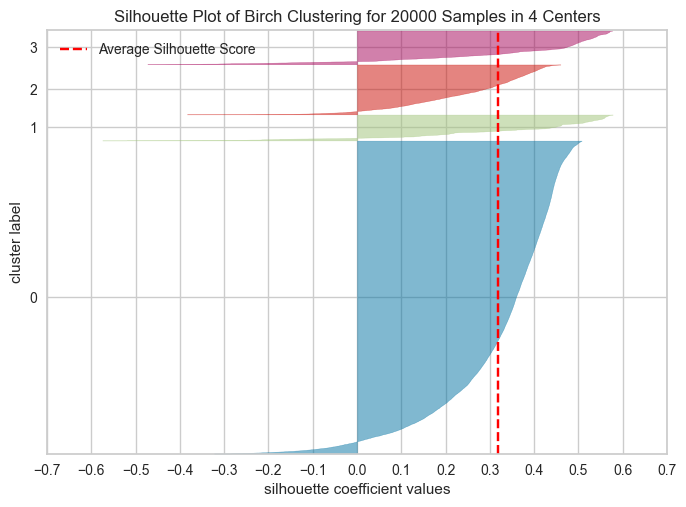

In [7]:

plot_model(dbscan, plot='silhouette')

##### MinMaxNormalization

In [23]:
from pycaret.clustering import *
s = setup(uptime_sample,normalize_method='minmax',normalize=True,session_id=123)
set = pull()
print(set)

               Description                 Value
0               Session id                   123
1      Original data shape           (20000, 12)
2   Transformed data shape           (20000, 12)
3         Numeric features                    12
4               Preprocess                  True
5          Imputation type                simple
6       Numeric imputation                  mean
7   Categorical imputation                  mode
8                Normalize                  True
9         Normalize method                minmax
10                CPU Jobs                    -1
11                 Use GPU                 False
12          Log Experiment                 False
13         Experiment Name  cluster-default-name
14                     USI                  27b2


In [18]:
models()

,Name,Reference
ID,,
kmeans,K-Means Clustering,sklearn.cluster._kmeans.KMeans
ap,Affinity Propagation,sklearn.cluster._affinity_propagation.Affinity...
meanshift,Mean Shift Clustering,sklearn.cluster._mean_shift.MeanShift
sc,Spectral Clustering,sklearn.cluster._spectral.SpectralClustering
hclust,Agglomerative Clustering,sklearn.cluster._agglomerative.AgglomerativeCl...
dbscan,Density-Based Spatial Clustering,sklearn.cluster._dbscan.DBSCAN
optics,OPTICS Clustering,sklearn.cluster._optics.OPTICS
birch,Birch Clustering,sklearn.cluster._birch.Birch


In [31]:
birch = create_model('birch')
view = pull()
print(view)

,,
,,
Initiated,. . . . . . . . . . . . . . . . . .,17:42:09
Status,. . . . . . . . . . . . . . . . . .,Loading Dependencies
Estimator,. . . . . . . . . . . . . . . . . .,Compiling Library


Processing:   0%|          | 0/3 [00:00<?, ?it/s]

   Silhouette  Calinski-Harabasz  Davies-Bouldin  Homogeneity  Rand Index  \
0      0.2532           6296.817          1.4222            0           0   

   Completeness  
0             0  


In [32]:
birch_cluster = assign_model(birch)
view = pull()
print(view)
birch_cluster

   Silhouette  Calinski-Harabasz  Davies-Bouldin  Homogeneity  Rand Index  \
0      0.2532           6296.817          1.4222            0           0   

   Completeness  
0             0  


,ZM6_MillRPM,ZM6_MillFPM,ZM6_RightTension,ZM6_LeftTension,WMAX0,RMS0,GNDOFF0,ZCS0,WMAX1,ZCS1,RMS1,GNDOFF1,Cluster
0,36.899998,19.935530,2.514950e+02,2.405749e+02,0.030420,0.004507,1.652222,44448.0,0.016308,13099.0,0.004791,1.655029,Cluster 1
1,0.060000,0.000000,0.000000e+00,0.000000e+00,0.012417,0.006083,1.652084,202.0,0.017008,43435.0,0.003641,1.655729,Cluster 2
2,501.899963,271.483154,2.106037e+02,2.053019e+02,0.116624,0.028221,1.652221,35590.0,0.016706,28105.0,0.004052,1.654621,Cluster 3
3,37.079998,20.029552,1.234234e+02,1.167995e+02,0.018337,0.003005,1.655833,38647.0,0.031152,46792.0,0.005311,1.655908,Cluster 0
4,197.279984,106.626930,2.104457e+02,2.114675e+02,0.012268,0.006308,1.652234,102.0,0.017265,42369.0,0.003558,1.655986,Cluster 2
...,...,...,...,...,...,...,...,...,...,...,...,...,...
19995,151.619980,81.962082,1.860582e+02,1.895691e+02,0.012422,0.006560,1.652080,114.0,0.028280,47282.0,0.004832,1.655721,Cluster 2
19996,0.060000,0.000000,2.933714e-18,3.016484e-18,0.011702,0.005772,1.652800,1750.0,0.019750,44953.0,0.003894,1.656054,Cluster 2
19997,37.079998,20.091722,3.608587e+02,3.073553e+02,0.049345,0.011296,1.652214,16749.0,0.019144,41192.0,0.004199,1.655026,Cluster 1
19998,0.060000,0.000000,0.000000e+00,0.000000e+00,0.011987,0.005626,1.652515,3576.0,0.028809,47921.0,0.005041,1.655029,Cluster 2


In [33]:
plot_model(birch, plot = 'cluster')

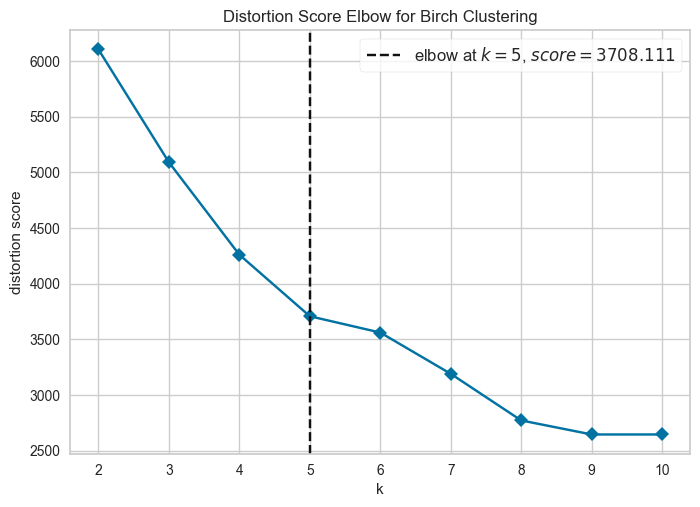

In [34]:
plot_model(birch, plot = 'elbow')

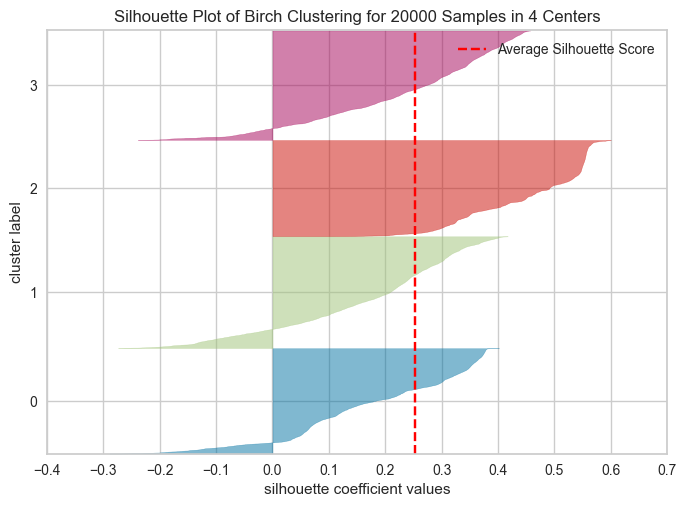

In [35]:
plot_model(birch, plot = 'silhouette')

In [36]:
optics = create_model('optics')
view = pull()
print(view)

,,
,,
Initiated,. . . . . . . . . . . . . . . . . .,17:43:16
Status,. . . . . . . . . . . . . . . . . .,Loading Dependencies
Estimator,. . . . . . . . . . . . . . . . . .,Compiling Library


Processing:   0%|          | 0/3 [00:00<?, ?it/s]

   Silhouette  Calinski-Harabasz  Davies-Bouldin  Homogeneity  Rand Index  \
0     -0.1146             20.128          1.1888            0           0   

   Completeness  
0             0  


In [37]:
optics_cluster = assign_model(optics)
view = pull()
print(view)
optics_cluster

   Silhouette  Calinski-Harabasz  Davies-Bouldin  Homogeneity  Rand Index  \
0     -0.1146             20.128          1.1888            0           0   

   Completeness  
0             0  


,ZM6_MillRPM,ZM6_MillFPM,ZM6_RightTension,ZM6_LeftTension,WMAX0,RMS0,GNDOFF0,ZCS0,WMAX1,ZCS1,RMS1,GNDOFF1,Cluster
0,36.899998,19.935530,2.514950e+02,2.405749e+02,0.030420,0.004507,1.652222,44448.0,0.016308,13099.0,0.004791,1.655029,Cluster -1
1,0.060000,0.000000,0.000000e+00,0.000000e+00,0.012417,0.006083,1.652084,202.0,0.017008,43435.0,0.003641,1.655729,Cluster 1081
2,501.899963,271.483154,2.106037e+02,2.053019e+02,0.116624,0.028221,1.652221,35590.0,0.016706,28105.0,0.004052,1.654621,Cluster 817
3,37.079998,20.029552,1.234234e+02,1.167995e+02,0.018337,0.003005,1.655833,38647.0,0.031152,46792.0,0.005311,1.655908,Cluster 876
4,197.279984,106.626930,2.104457e+02,2.114675e+02,0.012268,0.006308,1.652234,102.0,0.017265,42369.0,0.003558,1.655986,Cluster 281
...,...,...,...,...,...,...,...,...,...,...,...,...,...
19995,151.619980,81.962082,1.860582e+02,1.895691e+02,0.012422,0.006560,1.652080,114.0,0.028280,47282.0,0.004832,1.655721,Cluster -1
19996,0.060000,0.000000,2.933714e-18,3.016484e-18,0.011702,0.005772,1.652800,1750.0,0.019750,44953.0,0.003894,1.656054,Cluster 1098
19997,37.079998,20.091722,3.608587e+02,3.073553e+02,0.049345,0.011296,1.652214,16749.0,0.019144,41192.0,0.004199,1.655026,Cluster 442
19998,0.060000,0.000000,0.000000e+00,0.000000e+00,0.011987,0.005626,1.652515,3576.0,0.028809,47921.0,0.005041,1.655029,Cluster 1104


In [38]:
plot_model(optics, plot = 'cluster')

In [39]:
plot_model(optics, plot = 'elbow')

TypeError: Plot Type not supported for this model.

<Figure size 800x550 with 0 Axes>

In [40]:
plot_model(optics, plot = 'silhouette')

TypeError: Plot Type not supported for this model.

<Figure size 800x550 with 0 Axes>

In [41]:
dbscan = create_model('dbscan')
view = pull()
print(view)
dbscan_cluster = assign_model(dbscan)
view = pull()
print(view)
print(dbscan_cluster)
plot_model(dbscan, plot = 'cluster')

,,
,,
Initiated,. . . . . . . . . . . . . . . . . .,17:55:34
Status,. . . . . . . . . . . . . . . . . .,Loading Dependencies
Estimator,. . . . . . . . . . . . . . . . . .,Compiling Library


Processing:   0%|          | 0/3 [00:00<?, ?it/s]

   Silhouette  Calinski-Harabasz  Davies-Bouldin  Homogeneity  Rand Index  \
0      0.3777            17.7636          1.6413            0           0   

   Completeness  
0             0  
   Silhouette  Calinski-Harabasz  Davies-Bouldin  Homogeneity  Rand Index  \
0      0.3777            17.7636          1.6413            0           0   

   Completeness  
0             0  
       ZM6_MillRPM  ZM6_MillFPM  ZM6_RightTension  ZM6_LeftTension     WMAX0  \
0        36.899998    19.935530      2.514950e+02     2.405749e+02  0.030420   
1         0.060000     0.000000      0.000000e+00     0.000000e+00  0.012417   
2       501.899963   271.483154      2.106037e+02     2.053019e+02  0.116624   
3        37.079998    20.029552      1.234234e+02     1.167995e+02  0.018337   
4       197.279984   106.626930      2.104457e+02     2.114675e+02  0.012268   
...            ...          ...               ...              ...       ...   
19995   151.619980    81.962082      1.860582e+02     1.89

In [44]:
model = create_model('hclust')
view = pull()
print(view)
model_cluster = assign_model(dbscan)
view = pull()
print(view)
print(model_cluster)
plot_model(model, plot = 'cluster')

,,
,,
Initiated,. . . . . . . . . . . . . . . . . .,17:58:54
Status,. . . . . . . . . . . . . . . . . .,Loading Dependencies
Estimator,. . . . . . . . . . . . . . . . . .,Compiling Library


Processing:   0%|          | 0/3 [00:00<?, ?it/s]

   Silhouette  Calinski-Harabasz  Davies-Bouldin  Homogeneity  Rand Index  \
0      0.2447          6154.3654          1.3922            0           0   

   Completeness  
0             0  
   Silhouette  Calinski-Harabasz  Davies-Bouldin  Homogeneity  Rand Index  \
0      0.2447          6154.3654          1.3922            0           0   

   Completeness  
0             0  
       ZM6_MillRPM  ZM6_MillFPM  ZM6_RightTension  ZM6_LeftTension     WMAX0  \
0        36.899998    19.935530      2.514950e+02     2.405749e+02  0.030420   
1         0.060000     0.000000      0.000000e+00     0.000000e+00  0.012417   
2       501.899963   271.483154      2.106037e+02     2.053019e+02  0.116624   
3        37.079998    20.029552      1.234234e+02     1.167995e+02  0.018337   
4       197.279984   106.626930      2.104457e+02     2.114675e+02  0.012268   
...            ...          ...               ...              ...       ...   
19995   151.619980    81.962082      1.860582e+02     1.89

In [45]:
model = create_model('sc')
view = pull()
print(view)
model_cluster = assign_model(model)
view = pull()
print(view)
print(model_cluster)
plot_model(model, plot = 'cluster')

,,
,,
Initiated,. . . . . . . . . . . . . . . . . .,17:59:39
Status,. . . . . . . . . . . . . . . . . .,Loading Dependencies
Estimator,. . . . . . . . . . . . . . . . . .,Compiling Library


Processing:   0%|          | 0/3 [00:00<?, ?it/s]

   Silhouette  Calinski-Harabasz  Davies-Bouldin  Homogeneity  Rand Index  \
0      0.2738          6821.7964          1.3263            0           0   

   Completeness  
0             0  
   Silhouette  Calinski-Harabasz  Davies-Bouldin  Homogeneity  Rand Index  \
0      0.2738          6821.7964          1.3263            0           0   

   Completeness  
0             0  
       ZM6_MillRPM  ZM6_MillFPM  ZM6_RightTension  ZM6_LeftTension     WMAX0  \
0        36.899998    19.935530      2.514950e+02     2.405749e+02  0.030420   
1         0.060000     0.000000      0.000000e+00     0.000000e+00  0.012417   
2       501.899963   271.483154      2.106037e+02     2.053019e+02  0.116624   
3        37.079998    20.029552      1.234234e+02     1.167995e+02  0.018337   
4       197.279984   106.626930      2.104457e+02     2.114675e+02  0.012268   
...            ...          ...               ...              ...       ...   
19995   151.619980    81.962082      1.860582e+02     1.89

In [46]:
model = create_model('meanshift')
view = pull()
print(view)
model_cluster = assign_model(model)
view = pull()
print(view)
print(model_cluster)
plot_model(model, plot = 'cluster')

,,
,,
Initiated,. . . . . . . . . . . . . . . . . .,18:00:41
Status,. . . . . . . . . . . . . . . . . .,Loading Dependencies
Estimator,. . . . . . . . . . . . . . . . . .,Compiling Library


Processing:   0%|          | 0/3 [00:00<?, ?it/s]

   Silhouette  Calinski-Harabasz  Davies-Bouldin  Homogeneity  Rand Index  \
0        0.31            10.7952          0.7928            0           0   

   Completeness  
0             0  
   Silhouette  Calinski-Harabasz  Davies-Bouldin  Homogeneity  Rand Index  \
0        0.31            10.7952          0.7928            0           0   

   Completeness  
0             0  
       ZM6_MillRPM  ZM6_MillFPM  ZM6_RightTension  ZM6_LeftTension     WMAX0  \
0        36.899998    19.935530      2.514950e+02     2.405749e+02  0.030420   
1         0.060000     0.000000      0.000000e+00     0.000000e+00  0.012417   
2       501.899963   271.483154      2.106037e+02     2.053019e+02  0.116624   
3        37.079998    20.029552      1.234234e+02     1.167995e+02  0.018337   
4       197.279984   106.626930      2.104457e+02     2.114675e+02  0.012268   
...            ...          ...               ...              ...       ...   
19995   151.619980    81.962082      1.860582e+02     1.89

In [47]:
model = create_model('ap')
view = pull()
print(view)
model_cluster = assign_model(model)
view = pull()
print(view)
print(model_cluster)
plot_model(model, plot = 'cluster')

,,
,,
Initiated,. . . . . . . . . . . . . . . . . .,18:01:37
Status,. . . . . . . . . . . . . . . . . .,Loading Dependencies
Estimator,. . . . . . . . . . . . . . . . . .,Compiling Library


Processing:   0%|          | 0/3 [00:00<?, ?it/s]

   Silhouette  Calinski-Harabasz  Davies-Bouldin  Homogeneity  Rand Index  \
0      0.3135          1035.9752          1.0685            0           0   

   Completeness  
0             0  
   Silhouette  Calinski-Harabasz  Davies-Bouldin  Homogeneity  Rand Index  \
0      0.3135          1035.9752          1.0685            0           0   

   Completeness  
0             0  
       ZM6_MillRPM  ZM6_MillFPM  ZM6_RightTension  ZM6_LeftTension     WMAX0  \
0        36.899998    19.935530      2.514950e+02     2.405749e+02  0.030420   
1         0.060000     0.000000      0.000000e+00     0.000000e+00  0.012417   
2       501.899963   271.483154      2.106037e+02     2.053019e+02  0.116624   
3        37.079998    20.029552      1.234234e+02     1.167995e+02  0.018337   
4       197.279984   106.626930      2.104457e+02     2.114675e+02  0.012268   
...            ...          ...               ...              ...       ...   
19995   151.619980    81.962082      1.860582e+02     1.89

In [48]:
model = create_model('kmeans')
view = pull()
print(view)
model_cluster = assign_model(model)
view = pull()
print(view)
print(model_cluster)
plot_model(model, plot = 'cluster')

,,
,,
Initiated,. . . . . . . . . . . . . . . . . .,18:13:52
Status,. . . . . . . . . . . . . . . . . .,Loading Dependencies
Estimator,. . . . . . . . . . . . . . . . . .,Compiling Library


Processing:   0%|          | 0/3 [00:00<?, ?it/s]

   Silhouette  Calinski-Harabasz  Davies-Bouldin  Homogeneity  Rand Index  \
0       0.279          7107.6832          1.3511            0           0   

   Completeness  
0             0  
   Silhouette  Calinski-Harabasz  Davies-Bouldin  Homogeneity  Rand Index  \
0       0.279          7107.6832          1.3511            0           0   

   Completeness  
0             0  
       ZM6_MillRPM  ZM6_MillFPM  ZM6_RightTension  ZM6_LeftTension     WMAX0  \
0        36.899998    19.935530      2.514950e+02     2.405749e+02  0.030420   
1         0.060000     0.000000      0.000000e+00     0.000000e+00  0.012417   
2       501.899963   271.483154      2.106037e+02     2.053019e+02  0.116624   
3        37.079998    20.029552      1.234234e+02     1.167995e+02  0.018337   
4       197.279984   106.626930      2.104457e+02     2.114675e+02  0.012268   
...            ...          ...               ...              ...       ...   
19995   151.619980    81.962082      1.860582e+02     1.89